<a href="https://colab.research.google.com/github/HasibAlMuzdadid/Machine-Learning-and-Deep-Learning-Projects/blob/main/trigger%20word%20detection/trigger_word_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Trigger Word Detection**

We will construct a speech dataset and implement an algorithm for trigger word detection (sometimes also called keyword detection or wake word detection). 
 Trigger word detection is the technology that allows devices like Amazon Alexa, Google Home, Apple Siri and Baidu DuerOS to wake up upon hearing a certain word.  Here, our trigger word will be "activate". Every time it hears "activate", it will make a "chiming" sound. 

In [ ]:
pip install pydub

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import numpy as np
from pydub import AudioSegment
import matplotlib.pyplot as plt
import random
import sys
import io
import os
import glob
import IPython
from scipy.io import wavfile

In [ ]:
# helper function

# Load a wav file
def get_wav_info(wav_file):
    rate, data = wavfile.read(wav_file)
    return rate, data


# Calculate and plot spectrogram for a wav audio file
def graph_spectrogram(wav_file):
    rate, data = get_wav_info(wav_file)
    nfft = 200 # Length of each window segment
    fs = 8000 # Sampling frequencies
    noverlap = 120 # Overlap between windows
    nchannels = data.ndim
    if nchannels == 1:
        pxx, freqs, bins, im = plt.specgram(data, nfft, fs, noverlap = noverlap)
    elif nchannels == 2:
        pxx, freqs, bins, im = plt.specgram(data[:,0], nfft, fs, noverlap = noverlap)
    return pxx

In [ ]:
# Used to standardize volume of audio clip
def match_target_amplitude(sound, target_dBFS):
    change_in_dBFS = target_dBFS - sound.dBFS
    return sound.apply_gain(change_in_dBFS)

In [ ]:
# Load raw audio files for speech synthesis
def load_raw_audio(path):
    activates = []
    backgrounds = []
    negatives = []
    for filename in os.listdir(path + "activates"):
        if filename.endswith("wav"):
            activate = AudioSegment.from_wav(path + "activates/" + filename)
            activates.append(activate)
    for filename in os.listdir(path + "backgrounds"):
        if filename.endswith("wav"):
            background = AudioSegment.from_wav(path + "backgrounds/" + filename)
            backgrounds.append(background)
    for filename in os.listdir(path + "negatives"):
        if filename.endswith("wav"):
            negative = AudioSegment.from_wav(path + "negatives/" + filename)
            negatives.append(negative)
    return activates, negatives, backgrounds

**Data Synthesis: Creating Speech Dataset** 

A speech dataset should ideally be as close as possible to the application we will want to run it on. In this case, we'd like to detect the word "activate" in working environments (library, home, offices, open-spaces ...). Therefore, we need to create recordings with a mix of positive words ("activate") and negative words (random words other than activate) on different background sounds. 

**Listening Data**  

A dataset is created by recording background noises as well as snippets of audio of people saying positive/negative words from libraries, cafes, restaurants, homes and offices all around the region. This dataset includes people speaking in a variety of accents. 
In the raw_data directory, we will find a subset of the raw audio files of the positive words, negative words and background noise. We will use these audio files to synthesize a dataset to train the model. The "activate" directory contains positive examples of people saying the word "activate". The "negatives" directory contains negative examples of people saying random words other than "activate". There is one word per audio recording. The "backgrounds" directory contains 10 second clips of background noise in different environments.



In [ ]:
IPython.display.Audio("/content/drive/MyDrive/colab files/raw_data/activates/1.wav")

In [ ]:
IPython.display.Audio("/content/drive/MyDrive/colab files/raw_data/negatives/4.wav")

In [ ]:
IPython.display.Audio("/content/drive/MyDrive/colab files/raw_data/backgrounds/1.wav")

**Audio Recordings to Spectrograms**


A microphone records little variations in air pressure over time and it is these little variations in air pressure that our ear also perceives as sound. 
One can think of an audio recording as a long list of numbers measuring the little air pressure changes detected by the microphone. We will use audio sampled at 44100 Hz (or 44100 Hertz). This means the microphone gives us 44,100 numbers per second. Thus, a 10 second audio clip is represented by 441,000 numbers (= $10 \times 44,100$). 

**Spectrogram**

It is quite difficult to figure out from this "raw" representation of audio whether the word "activate" was said. In  order to help sequence model more easily learn to detect trigger words, we will compute a *spectrogram* of the audio. 
* The spectrogram tells us how much different frequencies are present in an audio clip at any moment in time. 

* A spectrogram is computed by sliding a window over the raw audio signal and calculating the most active frequencies in each window using a Fourier transform. 

Let's look at an example. 

In [ ]:
IPython.display.Audio("/content/drive/MyDrive/colab files/audio_examples/example_train.wav")

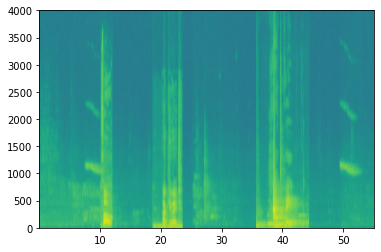

In [ ]:
x = graph_spectrogram("/content/drive/MyDrive/colab files/audio_examples/example_train.wav")

The graph represents how active each frequency is (y axis) over a number of time-steps (x axis). 




The color in the spectrogram shows the degree to which different frequencies are present (loud) in the audio at different points in time. 
* Green means a certain frequency is more active or more present in the audio clip (louder).
* Blue denotes less active frequencies.
* The dimension of the output spectrogram depends upon the hyperparameters of the spectrogram software and the length of the input. 

We will be working with 10 second audio clips as the "standard length" for our training examples. The number of timesteps of the spectrogram will be 5511. We'll see that the spectrogram will be the input $x$ into the network and so $T_x = 5511$.

In [ ]:
_, data = wavfile.read("/content/drive/MyDrive/colab files/audio_examples/example_train.wav")
print(f"Time steps in audio recording before spectrogram : {data[:,0].shape}")
print(f"Time steps in input after spectrogram : {x.shape}")

Time steps in audio recording before spectrogram : (441000,)
Time steps in input after spectrogram : (101, 5511)


In [ ]:
Tx = 5511     # The number of time steps input to the model from the spectrogram
n_freq = 101  # Number of frequencies input to the model at each time step of the spectrogram

**Dividing into Time Intervals**

We may divide a 10 second interval of time with different units (steps).
* Raw audio divides 10 seconds into 441,000 units.
* A spectrogram divides 10 seconds into 5,511 units.
  * $T_x = 5511$
* We will use a Python module `pydub` to synthesize audio and it divides 10 seconds into 10,000 units.
* The output of our model will divide 10 seconds into 1,375 units.
  * $T_y = 1375$
  * For each of the 1375 time steps, the model predicts whether someone recently finished saying the trigger word "activate". 
* All of these are hyperparameters and can be changed (except the 441000 which is a function of the microphone). 
* We have chosen values that are within the standard range used for speech systems.

In [ ]:
Ty = 1375    # The number of time steps in the output of our model

**Generating Single Training Example**

#### Benefits of synthesizing Data
Because speech data is hard to acquire and label we will synthesize training data using the audio clips of activates, negatives and backgrounds. It is quite slow to record lots of 10 second audio clips with random "activates" in it. Instead, it is easier to record lots of positives and negative words and record background noise separately (or download background noise from free online sources). 

#### Process for Synthesizing an audio clip
To synthesize a single training example we will:
  - Pick a random 10 second background audio clip
  - Randomly insert 0-4 audio clips of "activate" into this 10 sec clip
  - Randomly insert 0-2 audio clips of negative words into this 10 sec clip

Because of synthesizing the word "activate" into the background clip, we know exactly when in the 10 second clip the "activate" makes its appearance, this makes it easier to generate the labels $y^{\langle t \rangle}$ as well. 

#### Pydub

We will use the pydub package to manipulate audio. Pydub converts raw audio files into lists of Pydub data structures. Pydub uses 1ms as the discretization interval (1 ms is 1 millisecond = 1/1000 seconds). This is why a 10 second clip is always represented using 10,000 steps. 

In [ ]:
# Load audio segments using pydub 
activates, negatives, backgrounds = load_raw_audio("/content/drive/MyDrive/colab files/raw_data/")

print(f" background len should be 10,000 since it is a 10 sec clip\n {str(len(backgrounds[0]))}\n")
print(f" activate[0] len may be around 1000 since an `activate` audio clip is usually around 1 second (but varies a lot) \n {str(len(activates[0]))}\n")
print(f" activate[1] len: different `activate` clips can have different lengths\n {str(len(activates[1]))}\n")

 background len should be 10,000 since it is a 10 sec clip
 10000

 activate[0] len may be around 1000 since an `activate` audio clip is usually around 1 second (but varies a lot) 
 916

 activate[1] len: different `activate` clips can have different lengths
 1579



**Overlaying positive/negative 'word' audio clips on top of the background audio**

Given a 10 second background clip and a short audio clip containing a positive or negative word, we need to be able to "add" the word audio clip on top of the background audio.
We will be inserting multiple clips of positive/negative words into the background and we don't want to insert an "activate" or a random word somewhere that overlaps with another clip we had previously added. To ensure that the 'word' audio segments do not overlap when inserted, we will keep track of the times of previously inserted audio clips. To be clear, when we insert a 1 second "activate" into a 10 second clip of cafe noise, **we do not end up with an 11 sec clip.** The resulting audio clip is still 10 seconds long. Pydub allows us to do this. 


**Label positive/negative words**

The labels $y^{\langle t \rangle}$ represent whether or not someone has just finished saying "activate". 
  * $y^{\langle t \rangle} = 1$ when that clip has finished saying "activate".
  * Given a background clip, we can initialize $y^{\langle t \rangle}=0$ for all $t$, since the clip doesn't contain any "activate". 

When we insert or overlay an "activate" clip, we will also update labels for $y^{\langle t \rangle}$. Rather than updating the label of a single time step, we will update 50 steps of the output to have target label 1. Updating several consecutive time steps can make the training data more balanced. We will train a GRU (Gated Recurrent Unit) to detect when someone has **finished** saying "activate". 

#### Example

Suppose the synthesized "activate" clip ends at the 5 second mark in the 10 second audio - exactly halfway into the clip. 
*  $T_y = 1375$, so timestep $687 = $ `int(1375*0.5)` corresponds to the moment 5 seconds into the audio clip. 
* Set $y^{\langle 688 \rangle} = 1$. 
* We will allow the GRU to detect "activate" anywhere within a short time-internal **after** this moment, so we actually **set 50 consecutive values** of the label $y^{\langle t \rangle}$ to 1. Specifically, we have $y^{\langle 688 \rangle} = y^{\langle 689 \rangle} = \cdots = y^{\langle 737 \rangle} = 1$.  



Synthesized data is easier to label: It's relatively straightforward to generate these labels $y^{\langle t \rangle}$ as described above. In contrast, if we have 10sec of audio recorded on a microphone, it's quite time consuming for a person to listen to it and mark manually exactly when "activate" finished. 

#### Helper Functions

To implement the training set synthesis process, we will use the following helper functions. All of these functions will use a 1ms discretization interval. The 10 seconds of audio is always discretized into 10,000 steps. 


1. `get_random_time_segment(segment_ms)`
    * Retrieves a random time segment from the background audio.
2. `is_overlapping(segment_time, existing_segments)`
    * Checks if a time segment overlaps with existing segments
3. `insert_audio_clip(background, audio_clip, existing_times)`
    * Inserts an audio segment at a random time in the background audio
    * Uses the functions `get_random_time_segment` and `is_overlapping`
4. `insert_ones(y, segment_end_ms)`
    * Inserts additional 1's into the label vector y after the word "activate"

In [ ]:
# returns a random time segment onto which we can insert an audio clip of duration segment_ms.

def get_random_time_segment(segment_ms):
    # Arguments:
    # segment_ms -> the duration of the audio clip in ms ("ms" stands for "milliseconds")
    
    # Returns:
    # segment_time -> a tuple of (segment_start, segment_end) in ms
    
    segment_start = np.random.randint(low=0, high=10000-segment_ms)    # Make sure segment doesn't run past the 10sec background 
    segment_end = segment_start + segment_ms - 1
    
    return (segment_start, segment_end)

#### Check if audio clips are overlapping

Suppose we have inserted audio clips at segments (1000,1800) and (3400,4500). The first segment starts at step 1000 and ends at step 1800. The second segment starts at 3400 and ends at 4500.

If we are considering whether to insert a new audio clip at (3000,3600) does this overlap with one of the previously inserted segments? 
* In this case, (3000,3600) and (3400,4500) overlap, so we should decide against inserting a clip here.

For the purpose of this function, define (100,200) and (200,250) to be overlapping, since they overlap at timestep 200. (100,199) and (200,250) are non-overlapping. 

For implementing this:

1. Creating a "False" flag, that we will later set to "True" if we find that there is an overlap.
2. Looping over the previous_segments' start and end times. Comparing these times to the segment's start and end times. If there is an overlap, setting the flag defined in (1) as True. 


So, there is overlap if:
* The new segment starts before the previous segment ends **and**
* The new segment ends after the previous segment starts.

In [ ]:
# Checks if the time of a segment overlaps with the times of existing segments.

def is_overlapping(segment_time, previous_segments):
    # Arguments:
    # segment_time -> a tuple of (segment_start, segment_end) for the new segment
    # previous_segments -> a list of tuples of (segment_start, segment_end) for the existing segments
    
    # Returns:
    # True if the time segment overlaps with any of the existing segments, False otherwise.
    
    segment_start, segment_end = segment_time
    
    # Step 1: Initialize overlap as a "False" flag. 
    overlap = False
    
    # Step 2: loop over the previous_segments start and end times.
    # Compare start/end times and set the flag to True if there is an overlap 
    for previous_start, previous_end in previous_segments: 
        if segment_start <= previous_end and segment_end >= previous_start:
            overlap = True
            break

    return overlap

In [ ]:
overlap1 = is_overlapping((950, 1430), [(2000, 2550), (260, 949)])
overlap2 = is_overlapping((2305, 2950), [(824, 1532), (1900, 2305), (3424, 3656)])
print(f"Overlap 1 =  {overlap1}")
print(f"Overlap 2 =  {overlap2}")

Overlap 1 =  False
Overlap 2 =  True


#### Insert Audio Clip

Using the previous helper functions to insert a new audio clip onto the 10 second background at a random time. We will ensure that any newly inserted segment doesn't overlap with previously inserted segments. 

For implementing this:

1. Getting the length of the audio clip that is to be inserted. (Getting a random time segment whose duration equals the duration of the audio clip that is to be inserted).
2. The time segment should not overlap with any of the previous time segments. If it is overlapping, then go back to step 1 and pick a new time segment.
3. Appending the new time segment to the list of existing time segments. This keeps track of all the segments we've inserted.  
4. Overlaying the audio clip over the background using pydub. 

In [ ]:
# Insert a new audio segment over the background noise at a random time step, ensuring that the 
# audio segment does not overlap with existing segments.

def insert_audio_clip(background, audio_clip, previous_segments):
    # Arguments:
    # background -> a 10 second background audio recording.  
    # audio_clip -> the audio clip to be inserted/overlaid. 
    # previous_segments -> times where audio segments have already been placed
    
    # Returns:
    # new_background -> the updated background audio

    
    # Get the duration of the audio clip in ms
    segment_ms = len(audio_clip)
     
    # Step 1: Use one of the helper functions to pick a random time segment onto which to insert the new audio clip. 
    segment_time = get_random_time_segment(segment_ms)
    
    # Step 2: Check if the new segment_time overlaps with one of the previous_segments. If so, keep 
    # picking new segment_time at random until it doesn't overlap. To avoid an endless loop    
    retry = 5     # we retry 5 times
    while is_overlapping(segment_time, previous_segments) and retry >= 0:
        segment_time = get_random_time_segment(segment_ms)
        retry = retry - 1
        #print(segment_time)
    
    # if last try is not overlaping, insert it to the background
    if not is_overlapping(segment_time, previous_segments):

        # Step 3: Append the new segment_time to the list of previous_segments 
        previous_segments.append(segment_time)

        # Step 4: Superpose audio segment and background
        new_background = background.overlay(audio_clip, position = segment_time[0])
    else:
        #print("Timeouted")
        new_background = background
        segment_time = (10000, 10000)
    
    return new_background, segment_time

In [ ]:
audio_clip, segment_time = insert_audio_clip(backgrounds[0], activates[0], [(3790, 4400)])
audio_clip.export("/content/drive/MyDrive/colab files/insert_test.wav", format="wav")
print(f"Segment Time: {segment_time}")
IPython.display.Audio("/content/drive/MyDrive/colab files/insert_test.wav")

Segment Time: (5801, 6716)


#### Insert Ones for Labels of Positive Target

Implementing to update the labels $y^{\langle t \rangle}$, assuming we've inserted an "activate" audio clip.
Here, `y` is a `(1,1375)` dimensional vector since $T_y = 1375$. 

If the "activate" audio clip ends at time step $t$, then set $y^{\langle t+1 \rangle} = 1$ and also set the next 49 additional consecutive values to 1.
* If the target word appears near the end of the entire audio clip, there may not be 50 additional time steps to set to 1.
* We should not run off the end of the array and try to update `y[0][1375]`, since the valid indices are `y[0][0]` through `y[0][1374]` because $T_y = 1375$. 
* So if "activate" ends at step 1370, we will get only set `y[0][1371] = y[0][1372] = y[0][1373] = y[0][1374] = 1`

For implementing this:

We can use a for loop. If we want to use Python's array slicing operations, we can do so as well.
* If a segment ends at `segment_end_ms` (using a 10000 step discretization), to convert it to the indexing for the outputs $y$ (using a $1375$ step discretization), we will use this formula:  
```
    segment_end_y = int(segment_end_ms * Ty / 10000.0)
```

In [ ]:
# Update the label vector y. The labels of the 50 output steps strictly after the end of the segment should be set to 1. 
# By strictly we mean that the label of segment_end_y should be 0 while, the 50 following labels should be ones. 

def insert_ones(y, segment_end_ms):
    # Arguments:
    # y -> numpy array of shape (1, Ty), the labels of the training example
    # segment_end_ms -> the end time of the segment in ms
    
    # Returns:
    # y -> updated labels

    _, Ty = y.shape
    
    # duration of the background (in terms of spectrogram time-steps)
    segment_end_y = int(segment_end_ms * Ty / 10000.0)
    
    if segment_end_y < Ty:
        # Add 1 to the correct index in the background label (y)
        for i in range(segment_end_y + 1, segment_end_y + 51):
            if i < Ty:
                y[0, i] = 1
    
    return y

sanity checks: (0.0, 1.0, 0.0)


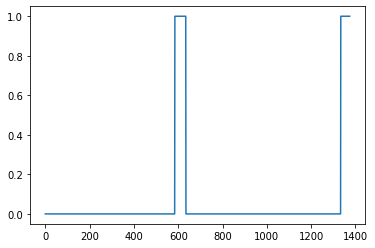

In [ ]:
arr1 = insert_ones(np.zeros((1, Ty)), 9700)
plt.plot(insert_ones(arr1, 4251)[0,:])
print(f"sanity checks: {arr1[0][1333], arr1[0][634], arr1[0][635]}")

Finally, we can use `insert_audio_clip` and `insert_ones` to create a new training example.



For implementing this:

1. Initializing the label vector $y$ as a numpy array of zeros and shape $(1, T_y)$.
2. Initializing the set of existing segments to an empty list.
3. Randomly selecting 0 to 4 "activate" audio clips and insert them onto the 10 second clip. Also inserting labels at the correct position in the label vector $y$.
4. Randomly selecting 0 to 2 negative audio clips and inserting them into the 10 second clip. 


In [ ]:
# Creates a training example with a given background, activates, and negatives.

def create_training_example(background, activates, negatives, Ty):
    # Arguments:
    # background -> a 10 second background audio recording
    # activates -> a list of audio segments of the word "activate"
    # negatives -> a list of audio segments of random words that are not "activate"
    # Ty -> The number of time steps in the output

    # Returns:
    # x -> the spectrogram of the training example
    # y -> the label at each time step of the spectrogram

    
    # Make background quieter
    background = background - 20

    # Step 1: Initialize y (label vector) of zeros 
    y = np.zeros((1, Ty))

    # Step 2: Initialize segment times as empty list 
    previous_segments = []
    
    # Select 0-4 random "activate" audio clips from the entire list of "activates" recordings
    number_of_activates = np.random.randint(0, 5)
    random_indices = np.random.randint(len(activates), size=number_of_activates)
    random_activates = [activates[i] for i in random_indices]
    
    # Step 3: Loop over randomly selected "activate" clips and insert in background
    for random_activate in random_activates: 
        # Insert the audio clip on the background
        background, segment_time = insert_audio_clip(background, random_activate, previous_segments)
        # Retrieve segment_start and segment_end from segment_time
        segment_start, segment_end = segment_time
        # Insert labels in "y" at segment_end
        y = insert_ones(y, segment_end)

    # Select 0-2 random negatives audio recordings from the entire list of "negatives" recordings
    number_of_negatives = np.random.randint(0, 3)
    random_indices = np.random.randint(len(negatives), size=number_of_negatives)
    random_negatives = [negatives[i] for i in random_indices]

    # Step 4: Loop over randomly selected negative clips and insert in background
    for random_negative in random_negatives: 
        # Insert the audio clip on the background 
        background, _ = insert_audio_clip(background, random_negative, previous_segments)
    
    # Standardize the volume of the audio clip 
    background = match_target_amplitude(background, -20.0)

    # Export new training example 
    file_handle = background.export("/content/drive/MyDrive/colab files/train.wav", format="wav")
    
    # Get and plot spectrogram of the new recording (background with superposition of positive and negatives)
    x = graph_spectrogram("/content/drive/MyDrive/colab files/train.wav")
    
    return x, y

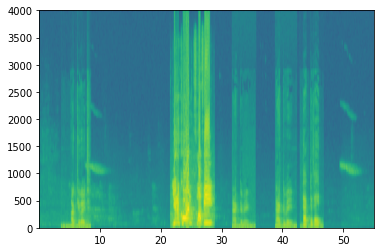

In [ ]:
x, y = create_training_example(backgrounds[0], activates, negatives, Ty)

In [ ]:
IPython.display.Audio("/content/drive/MyDrive/colab files/train.wav")

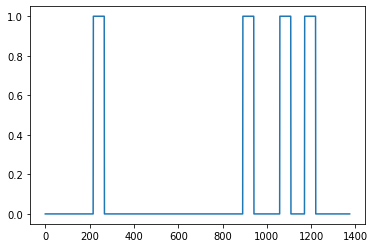

In [ ]:
# plot the associated labels for the generated training example
plt.plot(y[0])

**Full Training Set**

We've now implemented the code needed to generate a single training example. We used this process to generate a large training set. To save time we will generate a smaller training set of 32 examples. 

0
10
20
30


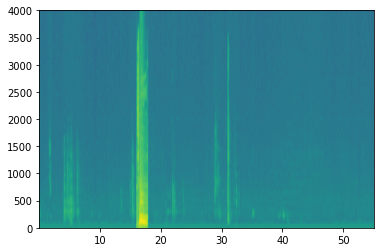

In [ ]:
nsamples = 32
X = []
Y = []
for i in range(0, nsamples):
    if i%10 == 0:
        print(i)
    x, y = create_training_example(backgrounds[i % 2], activates, negatives, Ty)
    X.append(x.swapaxes(0,1))
    Y.append(y.swapaxes(0,1))
X = np.array(X)
Y = np.array(Y)

In [ ]:
# Save the data for further uses
np.save(f"/content/drive/MyDrive/colab files/XY_train/X.npy", X)
np.save(f"/content/drive/MyDrive/colab files/XY_train/Y.npy", Y)

# Load the preprocessed training examples
X = np.load("/content/drive/MyDrive/colab files/XY_train/X.npy")
Y = np.load("/content/drive/MyDrive/colab files/XY_train/Y.npy")

**Development Set**

To test our model, we recorded a development set of 25 examples. 
While our training data is synthesized, we want to create a development set using the same distribution as the real inputs. 
Thus, we recorded 25 10-second audio clips of people saying "activate" and other random words and labeled them by hand. We should create the dev set to be as similar as possible to the test set distribution. This is why our **dev set uses real audio** rather than synthesized audio. 


In [ ]:
# Load preprocessed dev set examples
X_dev = np.load("/content/drive/MyDrive/colab files/XY_dev/X_dev.npy")
Y_dev = np.load("/content/drive/MyDrive/colab files/XY_dev/Y_dev.npy")

**Model**

We've built a dataset, let's write and train a trigger word detection model! The model will use 1-D convolutional layers, GRU layers and dense layers. 


In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.models import Model, load_model, Sequential
from tensorflow.keras.layers import Dense, Activation, Dropout, Input, Masking, TimeDistributed, LSTM, Conv1D
from tensorflow.keras.layers import GRU, Bidirectional, BatchNormalization, Reshape
from tensorflow.keras.optimizers import Adam

Our goal is to build a network that will ingest a spectrogram and output a signal when it detects the trigger word. This network will use 4 layers:
* A convolutional layer
* Two GRU layers
* A dense layer 

#### 1D convolutional layer
One key layer of this model is the 1D convolutional step 
* It inputs the 5511 step spectrogram.  Each step is a vector of 101 units
* It outputs a 1375 step output
* This output is further processed by multiple layers to get the final $T_y = 1375$ step output 
* This 1D convolutional layer plays a role similar to the 2D convolutions, of extracting low-level features and then possibly generating an output of a smaller dimension. 
* Computationally, the 1-D conv layer also helps speed up the model because now the GRU  can process only 1375 timesteps rather than 5511 timesteps. 

#### GRU, dense and sigmoid
* The two GRU layers read the sequence of inputs from left to right.
* A dense plus sigmoid layer makes a prediction for $y^{\langle t \rangle}$. 
* Because $y$ is a binary value (0 or 1), we use a sigmoid output at the last layer to estimate the chance of the output being 1, corresponding to the user having just said "activate".

#### Unidirectional RNN
* We use a **unidirectional RNN** rather than a bidirectional RNN. This is really important for trigger word detection, since we want to be able to detect the trigger word almost immediately after it is said. 
* If we used a bidirectional RNN, we would have to wait for the whole 10sec of audio to be recorded before we could tell if "activate" was said in the first second of the audio clip.  

**Implement The Model**

In the following model, the input of each layer is the output of the previous one. Implementing the model can be done in four steps. 

**Step 1**: CONV layer. Using `Conv1D()` to implement this with 196 filters, 
a filter size of 15 (`kernel_size=15`), and stride of 4. [conv1d](https://keras.io/layers/convolutional/#conv1d)

```Python
output_x = Conv1D(filters=...,kernel_size=...,strides=...)(input_x)
```
* Follow this with batch normalization.  No parameters need to be set.

```Python
output_x = BatchNormalization()(input_x)
```
* Follow this with a ReLu activation.  Note that we can pass in the name of the desired activation as a string, all in lowercase letters.

```Python
output_x = Activation("...")(input_x)
```

* Follow this with dropout, using a rate of 0.8 

```Python
output_x = Dropout(rate=...)(input_x)
```


**Step 2**: First GRU layer. To generate the GRU layer, using 128 units.
```Python
output_x = GRU(units=..., return_sequences = ...)(input_x)
```
* Return sequences instead of just the last time step's prediction to ensure that all the GRU's hidden states are fed to the next layer. 
* Follow this with dropout, using a rate of 0.8.
* Follow this with batch normalization.  No parameters need to be set.
```Python
output_x = BatchNormalization()(input_x)
```

**Step 3**: Second GRU layer. This has the same specifications as the first GRU layer.
* Follow this with a dropout, batch normalization and then another dropout.

**Step 4**: Creating a time-distributed dense layer as follows: 
```Python
output_x = TimeDistributed(Dense(1, activation = "sigmoid"))(input_x)
```
This creates a dense layer followed by a sigmoid, so that the parameters used for the dense layer are the same for every time step.  
Documentation:
* [Keras documentation on wrappers](https://keras.io/layers/wrappers/).  
* To learn more, visit: [How to Use the TimeDistributed Layer in Keras](https://machinelearningmastery.com/timedistributed-layer-for-long-short-term-memory-networks-in-python/).



In [ ]:
# Function creating the model's graph in Keras.

def modelf(input_shape):
    
    # Argument:
    # input_shape -> shape of the model's input data (using Keras conventions)

    # Returns:
    # model -> Keras model instance
    
    X_input = Input(shape = input_shape)
    
    
    # Step 1: CONV layer 
    # Add a Conv1D with 196 units, kernel size of 15 and stride of 4
    X = Conv1D(196, 15, 4)(X_input)
    # Batch normalization
    X = BatchNormalization()(X)
    # ReLu activation
    X = Activation("relu")(X)
    # dropout (use 0.8)
    X = Dropout(0.8)(X)                                   

    # Step 2: First GRU Layer 
    # GRU (use 128 units and return the sequences)
    X = GRU(128, return_sequences = True)(X)
    # dropout (use 0.8)
    X = Dropout(0.8)(X)
    # Batch normalization.
    X = BatchNormalization()(X)                           
    
    # Step 3: Second GRU Layer 
    # GRU (use 128 units and return the sequences)
    X = GRU(128, return_sequences = True)(X)
    # dropout (use 0.8)
    X = Dropout(0.8)(X)         
    # Batch normalization
    X = BatchNormalization()(X)
    # dropout (use 0.8)
    X = Dropout(0.8)(X)                                  
    
    # Step 4: Time-distributed dense layer   
    X = TimeDistributed(Dense(1, activation = "sigmoid"))(X)  # TimeDistributed  with sigmoid activation

    model = Model(inputs = X_input, outputs = X)
    
    return model  

In [ ]:
model = modelf(input_shape = (Tx, n_freq))

In [ ]:
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 5511, 101)]       0         
                                                                 
 conv1d (Conv1D)             (None, 1375, 196)         297136    
                                                                 
 batch_normalization (BatchN  (None, 1375, 196)        784       
 ormalization)                                                   
                                                                 
 activation (Activation)     (None, 1375, 196)         0         
                                                                 
 dropout (Dropout)           (None, 1375, 196)         0         
                                                                 
 gru (GRU)                   (None, 1375, 128)         125184    
                                                             

The output of the network is of shape (None, 1375, 1) while the input is (None, 5511, 101). The Conv1D has reduced the number of steps from 5511 to 1375. 

**Fit The Model**

Trigger word detection takes a long time to train. To save time, we will load a pre-trained model that has been already trained for about 3 hours on a GPU using the architecture built above and a large training set of about 4000 examples. 


In [ ]:
from tensorflow.keras.models import model_from_json

json_file = open("/content/drive/MyDrive/colab files/models/model.json", 'r')
loaded_model_json = json_file.read()
json_file.close()
model = model_from_json(loaded_model_json)
model.load_weights("/content/drive/MyDrive/colab files/models/model.h5")

**Block Training for BatchNormalization Layers**

If we are going to fine-tune a pretrained model, it is important that you block the weights of all our batchnormalization layers. If we are going to train a new model from scratch, we can skip this. 

In [ ]:
model.layers[2].trainable = False
model.layers[7].trainable = False
model.layers[10].trainable = False

We can train the model further, using the Adam optimizer and binary cross entropy loss as follows. This will run quickly because we are training just for two epochs and with a small training set of 32 examples. 

In [ ]:
opt = Adam(learning_rate=1e-6, beta_1=0.9, beta_2=0.999)
model.compile(loss='binary_crossentropy', optimizer=opt, metrics=["accuracy"])

In [ ]:
model.fit(X, Y, batch_size = 16, epochs=1)

2/2 [==============================] - 9s 3s/step - loss: 0.1716 - accuracy: 0.9488


**Test The Model**

Let's see how our model performs on the dev set.

In [ ]:
loss, acc, = model.evaluate(X_dev, Y_dev)
print(f"Dev set accuracy = {acc}")

1/1 [==============================] - 2s 2s/step - loss: 0.1887 - accuracy: 0.9239
Dev set accuracy = 0.9238690733909607


This looks pretty good! However, accuracy isn't a great metric for this task. Since the labels are heavily skewed to 0's, a neural network that just outputs 0's would get slightly over 90% accuracy. We could define more useful metrics such as F1 score or Precision/Recall. 
    
**Making Predictions**

Let's use this model to make predictions. This code snippet runs audio (saved in a wav file) through the network. 


In [ ]:
def detect_triggerword(filename):
    plt.subplot(2, 1, 1)
    
    # Correct the amplitude of the input file before prediction 
    audio_clip = AudioSegment.from_wav(filename)
    audio_clip = match_target_amplitude(audio_clip, -20.0)
    file_handle = audio_clip.export("/content/drive/MyDrive/colab files/tmp.wav", format="wav")
    filename = "/content/drive/MyDrive/colab files/tmp.wav"

    x = graph_spectrogram(filename)
    # the spectrogram outputs (freqs, Tx) and we want (Tx, freqs) to input into the model
    x  = x.swapaxes(0,1)
    x = np.expand_dims(x, axis=0)
    predictions = model.predict(x)
    
    plt.subplot(2, 1, 2)
    plt.plot(predictions[0,:,0])
    plt.ylabel('probability')
    plt.show()
    
    return predictions

**Insert a chime to acknowledge the "activate" trigger**
* Once we've estimated the probability of having detected the word "activate" at each output step, we can trigger a "chiming" sound to play when the probability is above a certain threshold. 
* $y^{\langle t \rangle}$ might be near 1 for many values in a row after "activate" is said, yet we want to chime only once. So we will insert a chime sound at most once every 75 output steps. This will help prevent us from inserting two chimes for a single instance of "activate". This plays a role similar to non-max suppression from computer vision.

In [ ]:
chime_file = "/content/drive/MyDrive/colab files/audio_examples/chime.wav"
def chime_on_activate(filename, predictions, threshold):
    audio_clip = AudioSegment.from_wav(filename)
    chime = AudioSegment.from_wav(chime_file)
    Ty = predictions.shape[1]
    # Step 1: Initialize the number of consecutive output steps to 0
    consecutive_timesteps = 0
    # Step 2: Loop over the output steps in the y
    for i in range(Ty):
        # Step 3: Increment consecutive output steps
        consecutive_timesteps += 1
        # Step 4: If prediction is higher than the threshold and more than 20 consecutive output steps have passed
        if consecutive_timesteps > 20:
            # Step 5: Superpose audio and background using pydub
            audio_clip = audio_clip.overlay(chime, position = ((i / Ty) * audio_clip.duration_seconds) * 1000)
            # Step 6: Reset consecutive output steps to 0
            consecutive_timesteps = 0
        # if amplitude is smaller than the threshold reset the consecutive_timesteps counter
        if predictions[0, i, 0] < threshold:
            consecutive_timesteps = 0
        
    audio_clip.export("/content/drive/MyDrive/colab files/chime_output.wav", format='wav')

**Test on Dev Examples**

Let's explore how model performs on two unseen audio clips from the development set. Lets first listen to the two dev set clips. 

In [ ]:
IPython.display.Audio("/content/drive/MyDrive/colab files/raw_data/dev/1.wav")

In [ ]:
IPython.display.Audio("/content/drive/MyDrive/colab files/raw_data/dev/2.wav")

Now lets run the model on these audio clips and see if it adds a chime after "activate"!

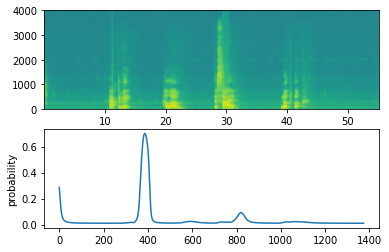

In [ ]:
filename = "/content/drive/MyDrive/colab files/raw_data/dev/1.wav"
prediction = detect_triggerword(filename)
chime_on_activate(filename, prediction, 0.5)
IPython.display.Audio("/content/drive/MyDrive/colab files/chime_output.wav")

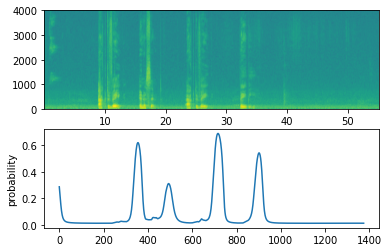

In [ ]:
filename  = "/content/drive/MyDrive/colab files/raw_data/dev/2.wav"
prediction = detect_triggerword(filename)
chime_on_activate(filename, prediction, 0.5)
IPython.display.Audio("/content/drive/MyDrive/colab files/chime_output.wav")

**Try Own Example!**

 

Recording a 10 second audio clip of saying the word "activate" and other random words and upload it to the directory. Have to be sure to upload the audio as a wav file. If audio recording is not 10 seconds, the code below will either trim or pad it as needed to make it 10 seconds. 

In [ ]:
# Preprocess the audio to the correct format
def preprocess_audio(filename):
    # Trim or pad audio segment to 10000ms
    padding = AudioSegment.silent(duration=10000)
    segment = AudioSegment.from_wav(filename)[:10000]
    segment = padding.overlay(segment)
    # Set frame rate to 44100
    segment = segment.set_frame_rate(44100)
    # Export as wav
    segment.export(filename, format='wav')

In [ ]:
your_filename = "/content/drive/MyDrive/colab files/audio_examples/my_audio.wav"

In [ ]:
preprocess_audio(your_filename)
IPython.display.Audio(your_filename) # listen to the uploaded audio

Finally, using the model to predict when someone says activate in the 10 second audio clip and trigger a chime. If beeps are not being added appropriately, try to adjust the chime_threshold.

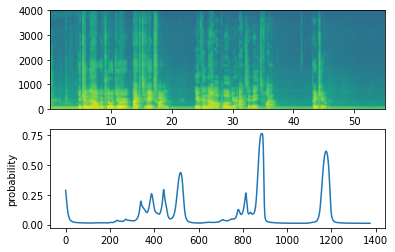

In [ ]:
chime_threshold = 0.3
prediction = detect_triggerword(your_filename)
chime_on_activate(your_filename, prediction, chime_threshold)
IPython.display.Audio("/content/drive/MyDrive/colab files/chime_output.wav")

Data synthesis is an effective way to create a large training set for speech problems, specifically trigger word detection. Using a spectrogram and optionally a 1D conv layer is a common pre-processing step prior to passing audio data to an RNN, GRU or LSTM. An end-to-end deep learning approach can be used to build a very effective trigger word detection system. 
